"""
This is the script that reads the landcover data exported from GEE. It reads
and analyzes the annual results. Time series plots and landcover transition 
will be done. All the figures/text files will be saved or exported for future 
use.

Created on Wed Mar 11 16:26:49 2020

@author: Shunan Feng sfeng@icrc.org
"""

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

import rasterio
from rasterio.plot import show

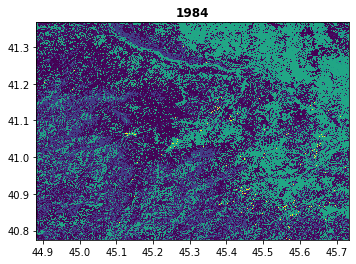

landcover changed  66.79376996733869 %



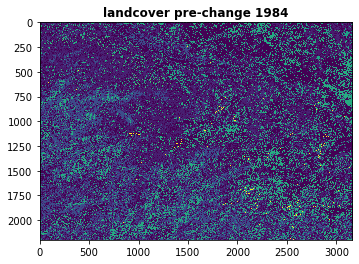

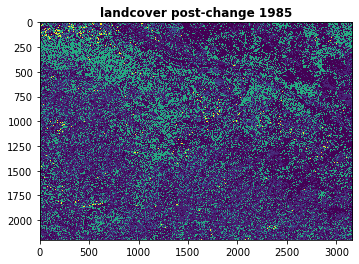

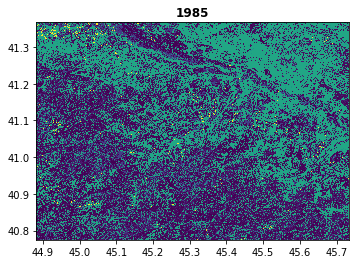

landcover changed  65.07303440536012 %



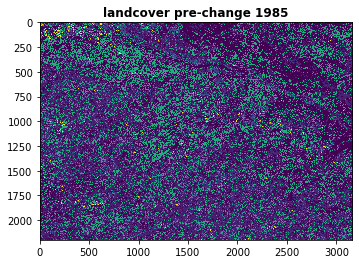

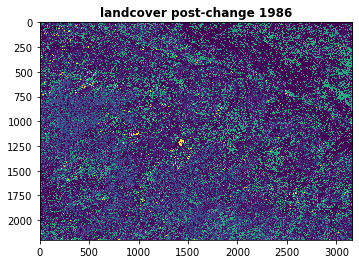

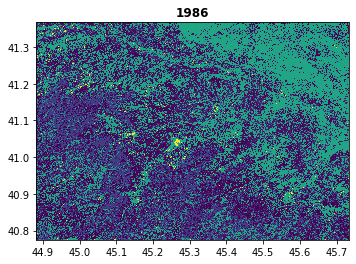

landcover changed  55.07776607209368 %



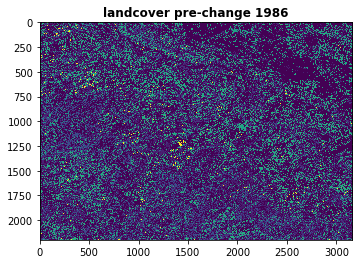

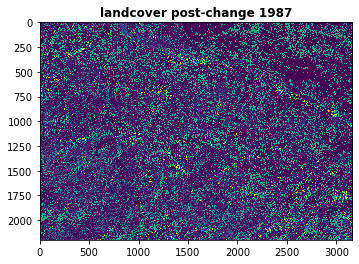

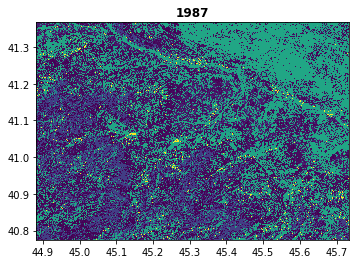

landcover changed  57.78914490337344 %



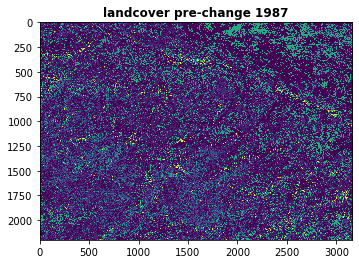

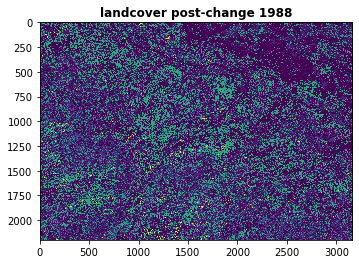

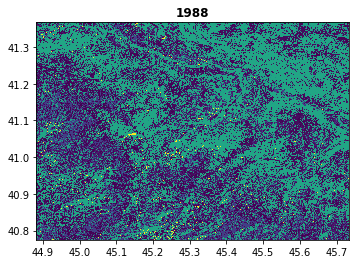

landcover changed  64.77540983441469 %



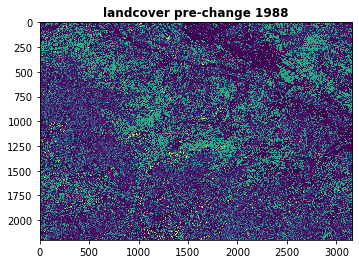

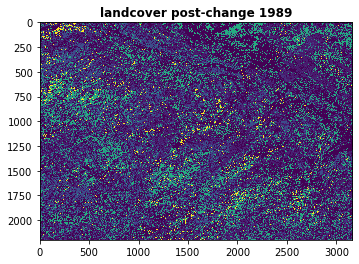

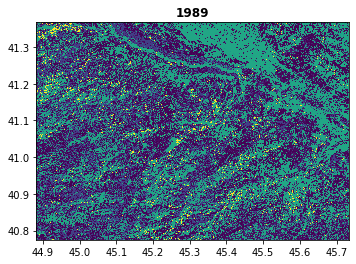

landcover changed  62.34587376074282 %



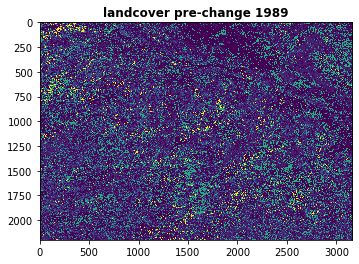

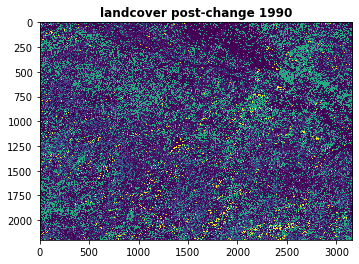

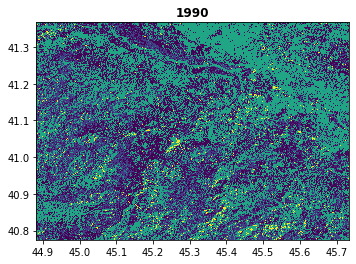

landcover changed  62.48972275943208 %



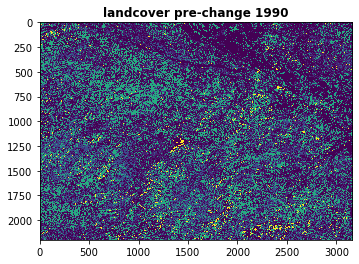

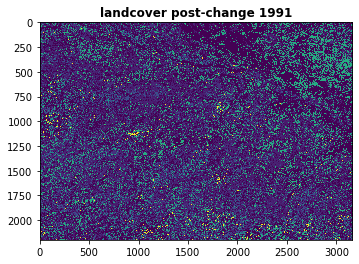

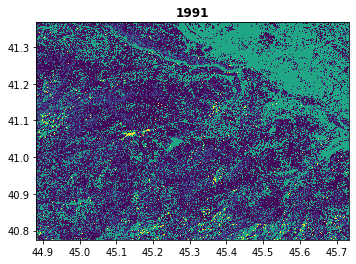

landcover changed  65.65756572506642 %



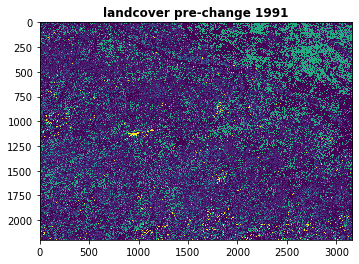

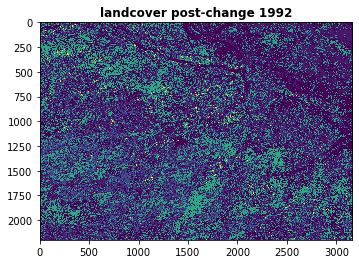

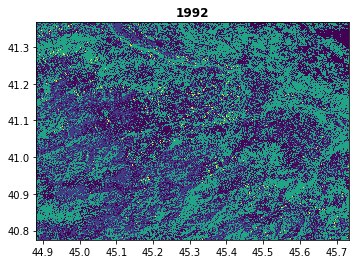

landcover changed  66.27745866481256 %



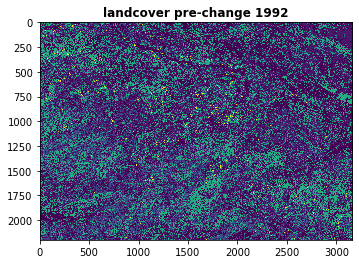

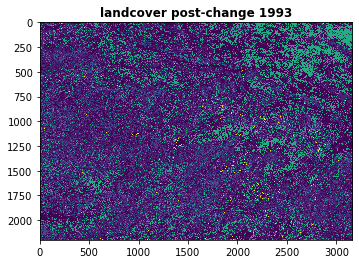

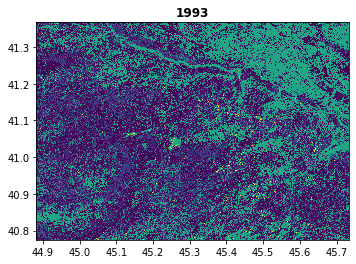

landcover changed  66.97938250670151 %



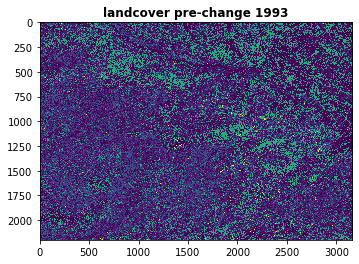

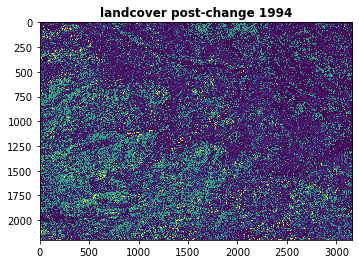

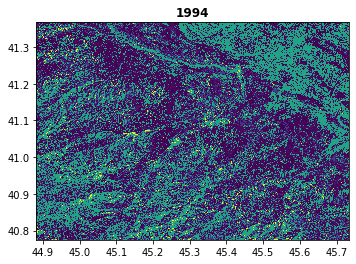

landcover changed  61.87851916814163 %



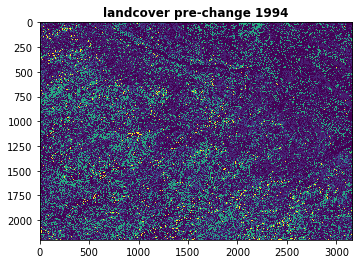

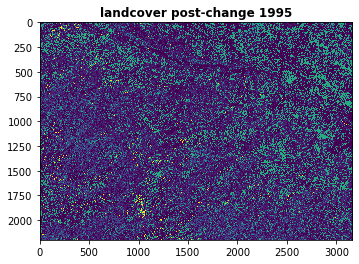

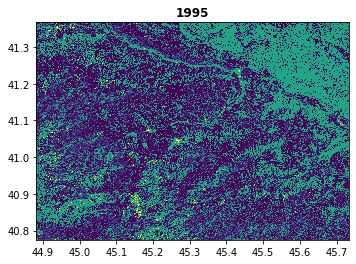

landcover changed  58.98322538544238 %



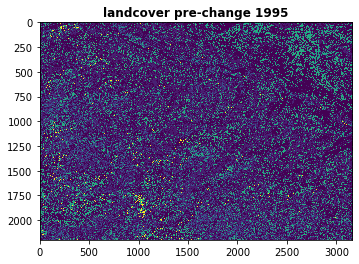

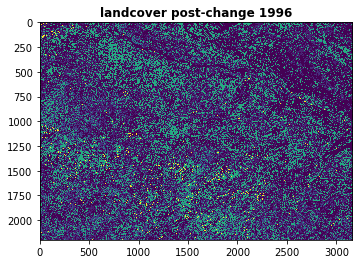

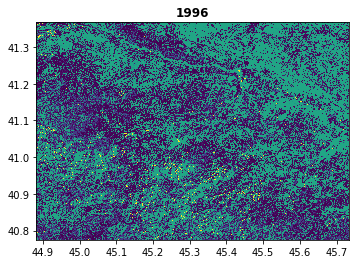

landcover changed  62.67055903441198 %



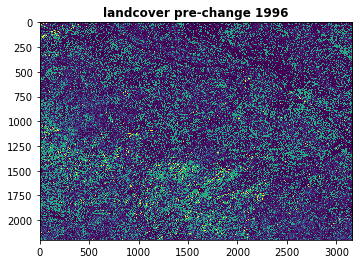

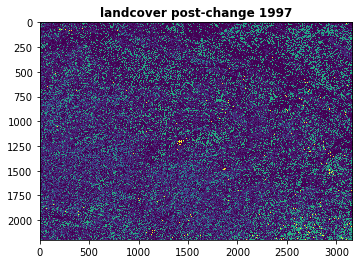

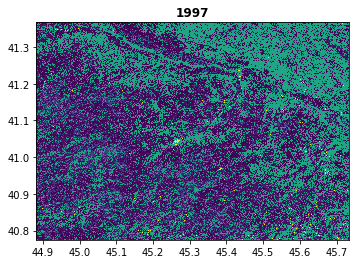

landcover changed  62.49124771131337 %



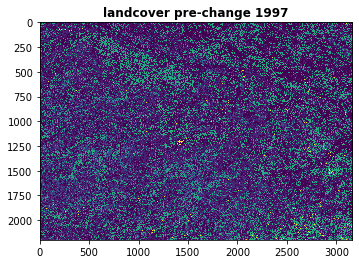

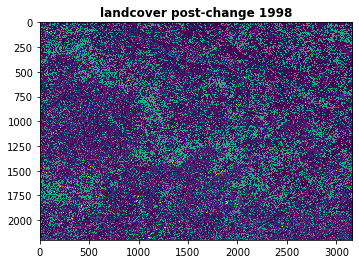

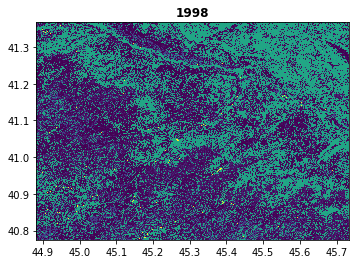

landcover changed  58.236977234626366 %



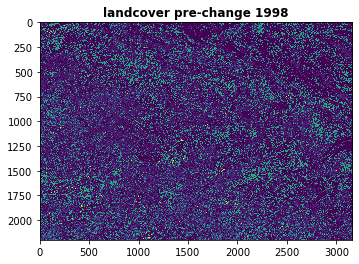

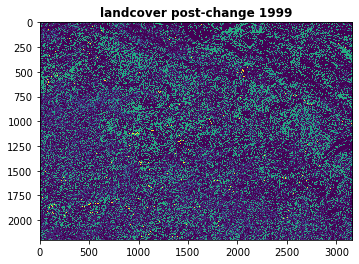

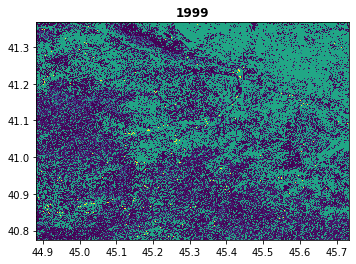

landcover changed  62.111865578656655 %



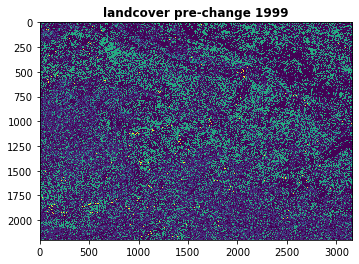

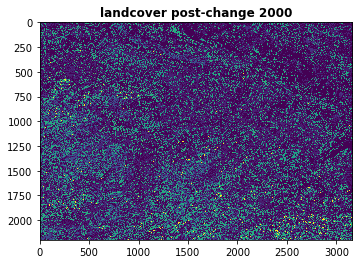

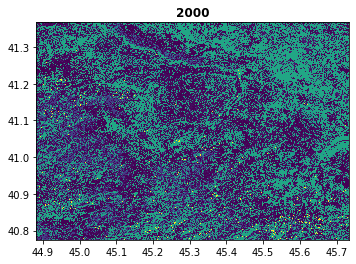

landcover changed  63.28636625402332 %



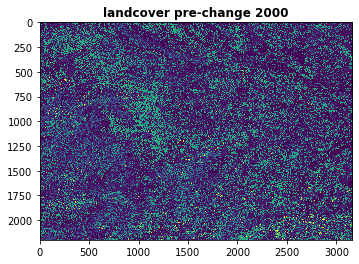

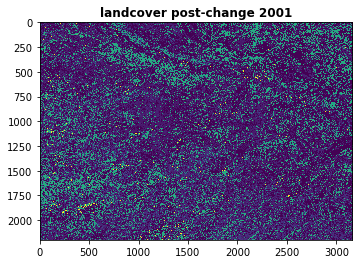

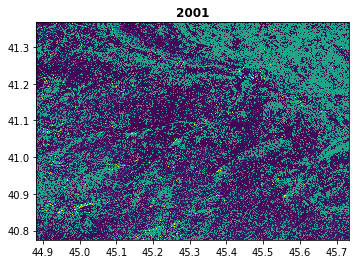

landcover changed  62.607590030785325 %



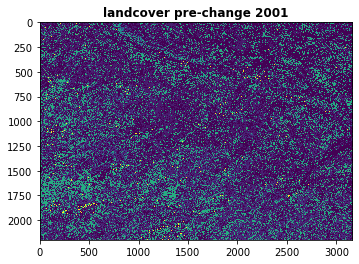

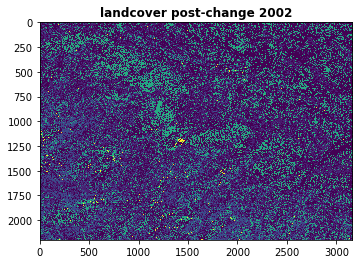

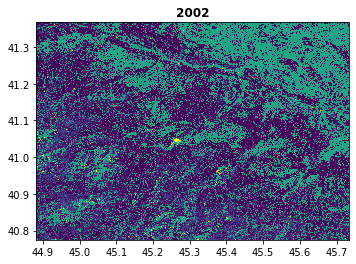

landcover changed  69.71366438887769 %



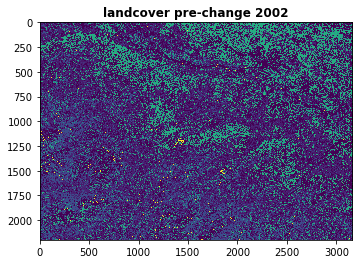

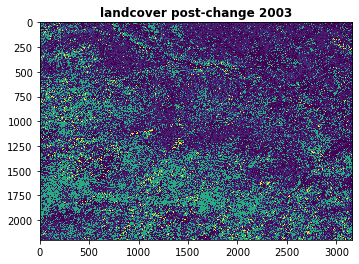

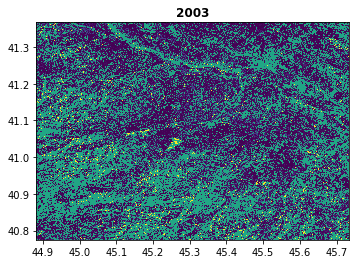

landcover changed  70.46794011657826 %



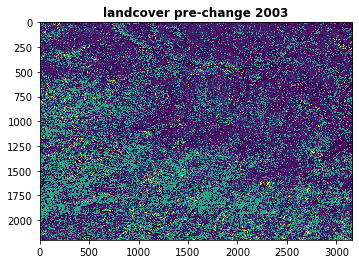

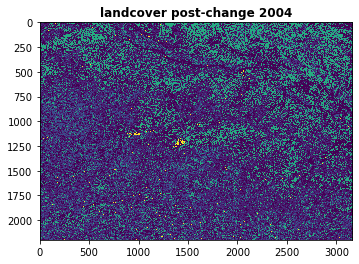

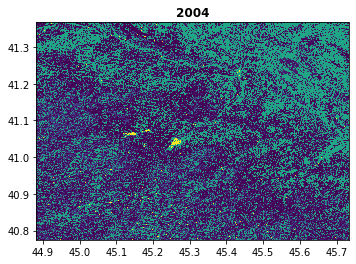

landcover changed  63.730616386989055 %



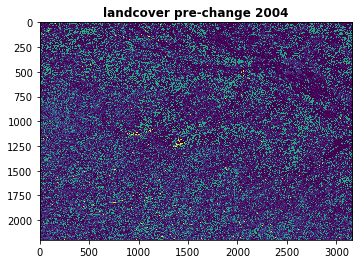

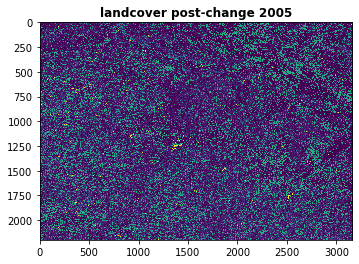

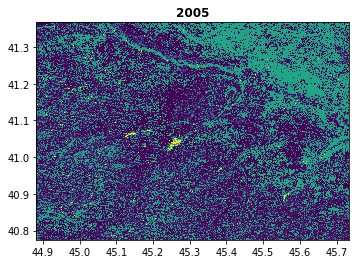

landcover changed  63.61440354456363 %



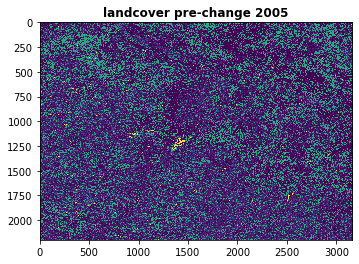

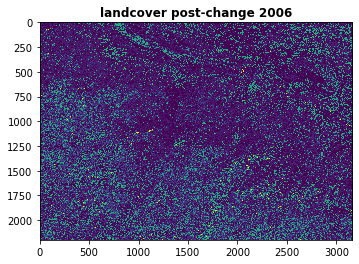

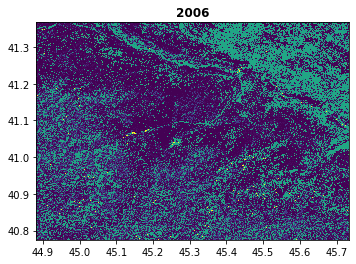

landcover changed  60.89757229099132 %



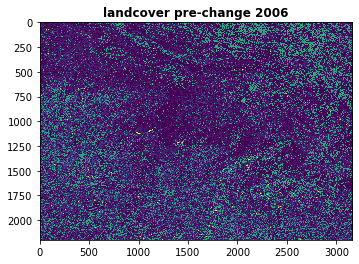

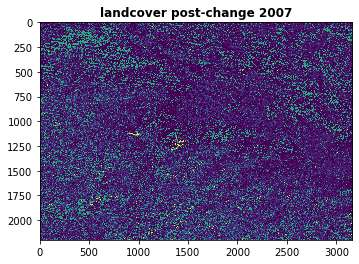

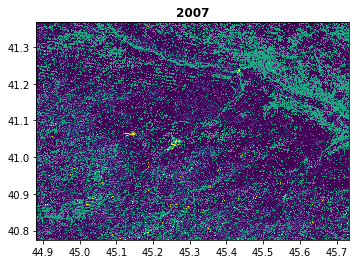

landcover changed  62.44686585703231 %



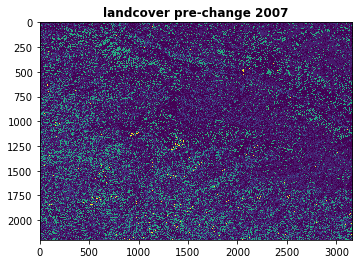

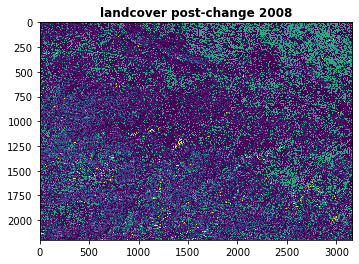

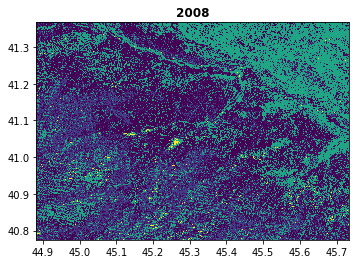

landcover changed  64.00673338187283 %



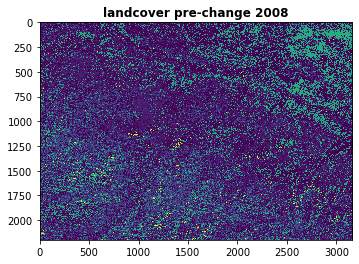

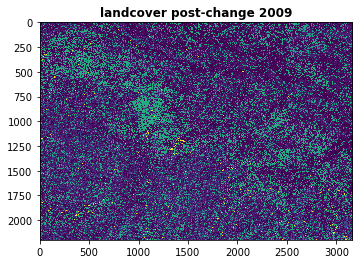

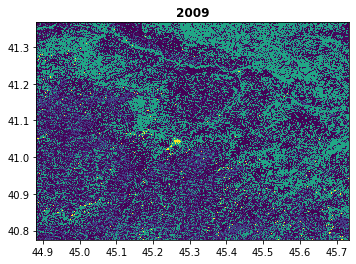

landcover changed  65.310783035457 %



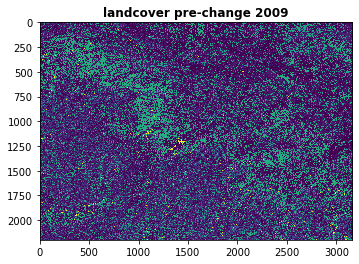

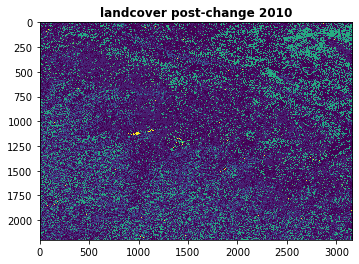

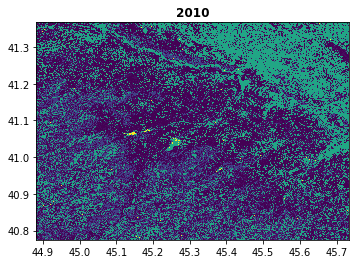

landcover changed  62.75188500596817 %



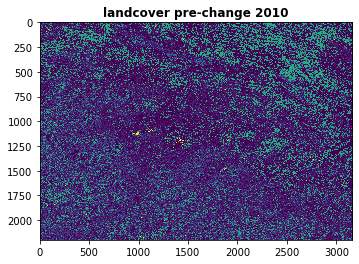

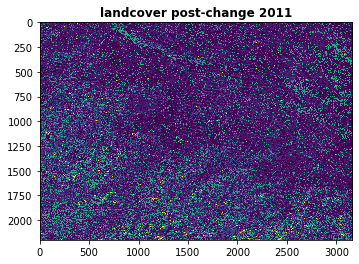

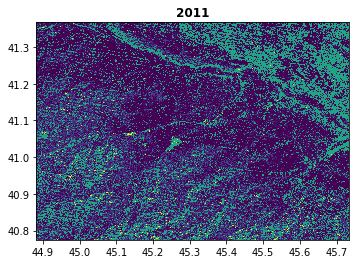

landcover changed  65.34295088834921 %



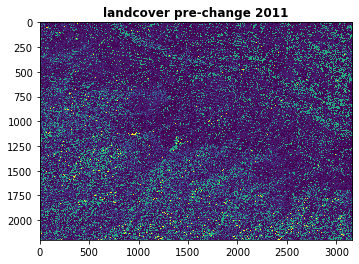

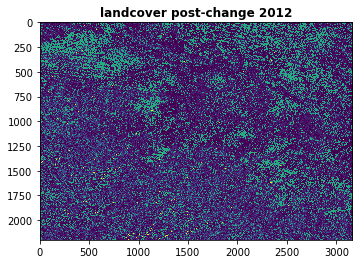

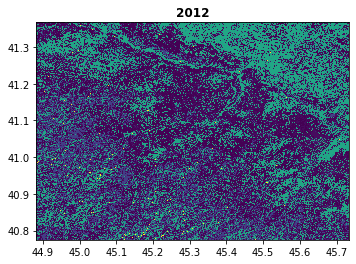

landcover changed  63.057666630844686 %



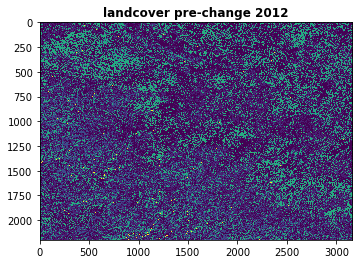

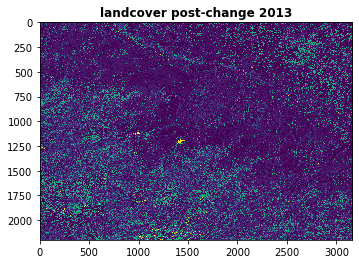

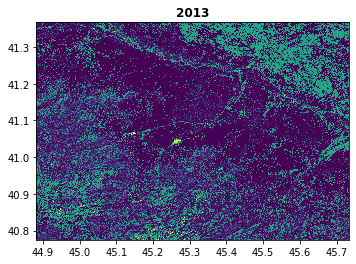

landcover changed  55.38420946854132 %



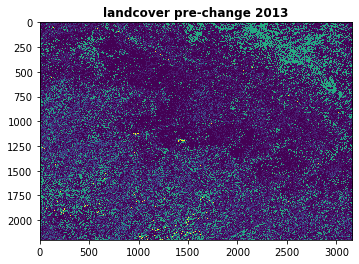

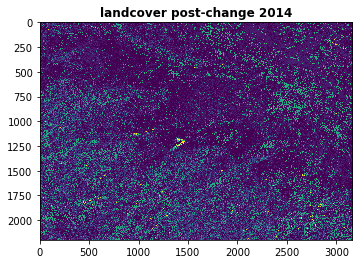

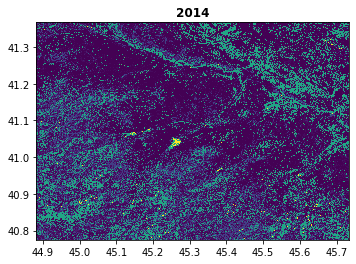

landcover changed  58.95028067027102 %



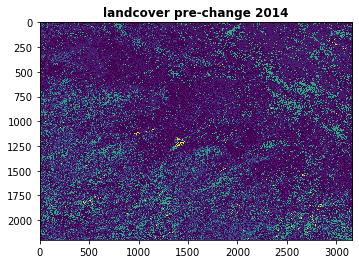

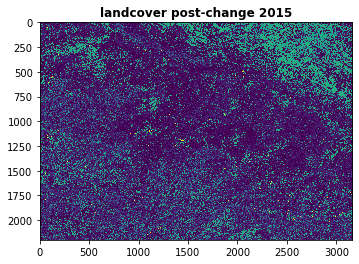

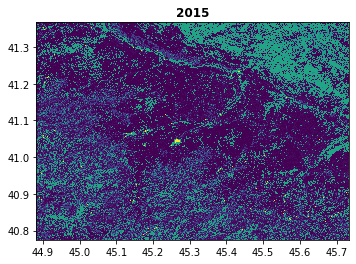

landcover changed  61.97759788141025 %



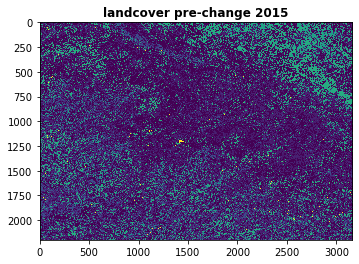

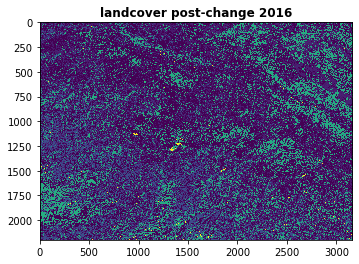

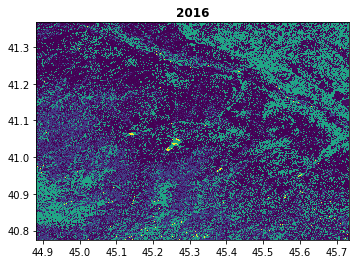

landcover changed  59.07993035285804 %



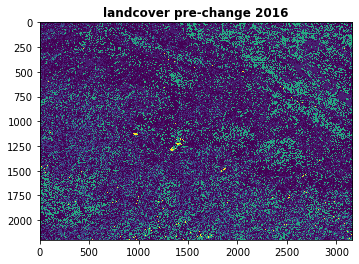

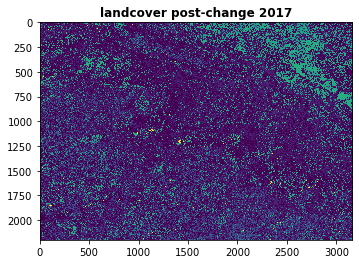

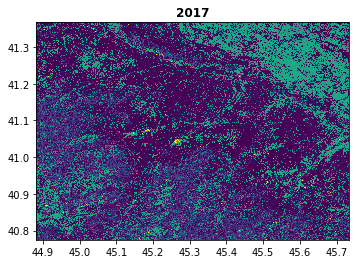

landcover changed  61.72770718161702 %



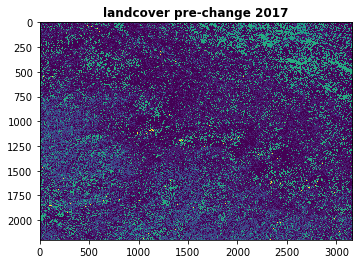

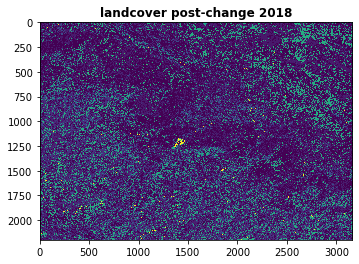

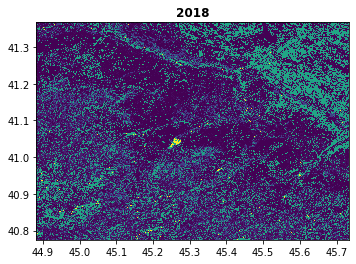

landcover changed  58.232215356581946 %



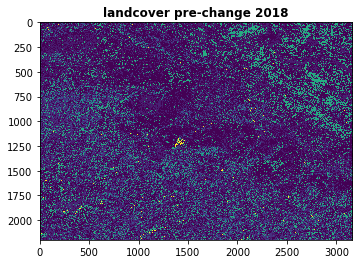

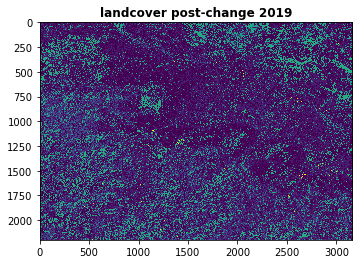

In [2]:
#%% lucc change
folder = r"tif/"
subdir = sorted(os.listdir(folder))
fileNum = len(subdir)

countsPixelc = np.ones((11, fileNum))
countsPixeld = np.ones((11, fileNum))

for i in range(fileNum - 1):
    with rasterio.open(folder + "\\" + subdir[i]) as src:
        A = src.read(1)
        titlestr = subdir[i][0:4]
        show(src, title=titlestr)
#        f1.savefig("output\landcover" + titlestr + ".png" , dpi = 300)
    with rasterio.open(folder + "\\" + subdir[i + 1]) as src:
        B = src.read(1)
#        titlestr = subdir[i + 1][0:4]
    abDiff = B - A
    index = np.nonzero(abDiff)
    print('landcover changed ', 100 * np.count_nonzero(abDiff) / np.count_nonzero(A), '%\n')
    C = np.zeros(np.shape(B))
    C[index] = A[index]
    figtitle = "landcover pre-change " + subdir[i][0:4]
    show(C, title = figtitle)
    uniqueC, counts = np.unique(C, return_counts=True)
    uniquePixel= np.delete(uniqueC, 0)
    countsPixelc[:, i] = np.delete(counts, 0)
#    f2.savefig("output\change\\" + figtitle + ".png" , dpi = 300)
    D = np.zeros(np.shape(B))
    D[index] = B[index]
    figtitle = "landcover post-change " + subdir[i + 1][0:4]
    show(D, title = figtitle)
    uniqueD, counts = np.unique(D, return_counts=True)
    # uniquePixeld[:, i] = np.delete(uniqueD, 0)
    countsPixeld[:, i] = np.delete(counts, 0)
np.savetxt('output\\countsPixelc.txt', countsPixelc)
np.savetxt('output\\countsPixeld.txt', countsPixeld)
# np.savetxt('output\\uniquePixelc.txt', uniquePixelc)
# np.savetxt('output\\uniquePixeld.txt', uniquePixeld)

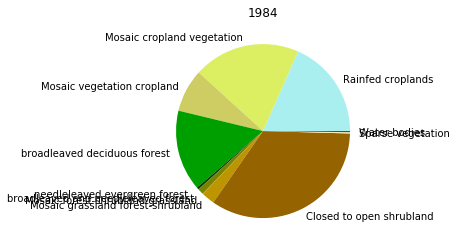

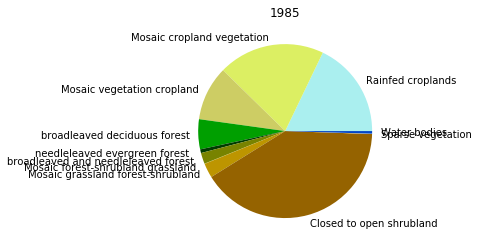

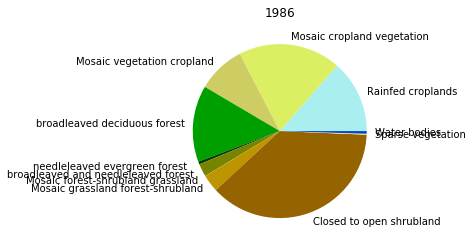

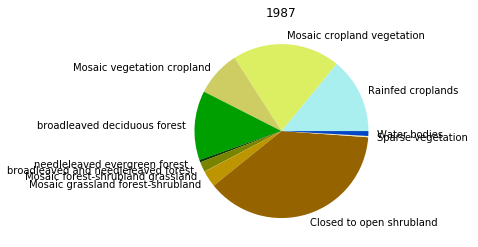

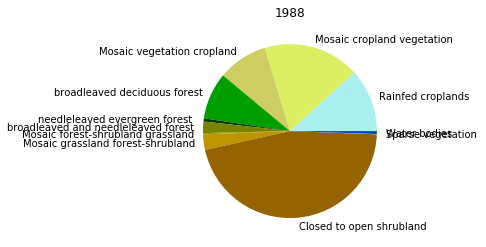

...

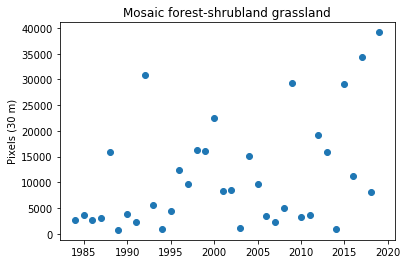

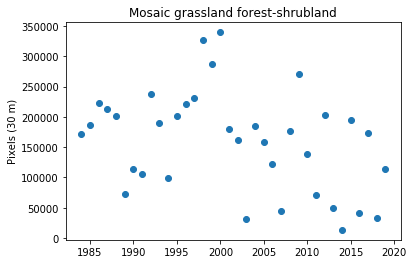

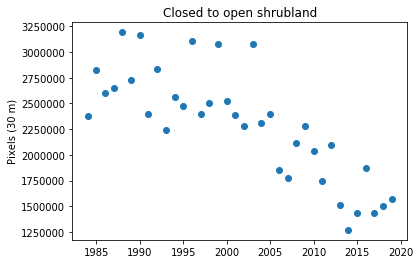

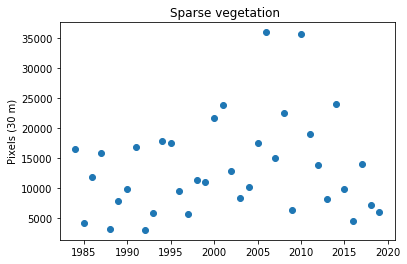

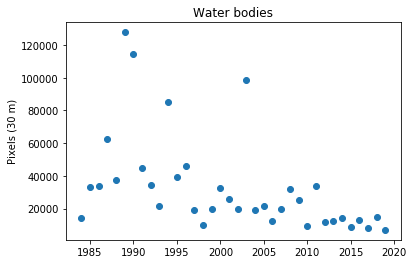

In [3]:
#%% lucc summary
folder = r"tif/"
subdir = sorted(os.listdir(folder))
fileNum = len(subdir)

uniquePixel = np.ones((11, fileNum))
countsPixel = np.ones((11, fileNum))

luccClass = 'Rainfed croplands', 'Mosaic cropland vegetation', \
             'Mosaic vegetation cropland', 'broadleaved deciduous forest', \
             'needleleaved evergreen forest ', \
             'broadleaved and needleleaved forest', \
             'Mosaic forest-shrubland grassland',\
             'Mosaic grassland forest-shrubland',\
             'Closed to open shrubland', 'Sparse vegetation ',\
             'Water bodies'
luccColor = ['#aaefef','#dcef63','#cdcd64','#009f00','#003b00','#788300',\
             '#8d9f00','#bd9500','#956300','#ffebae','#0046c7']

for i in range(fileNum):
    with rasterio.open(folder + "\\" + subdir[i]) as src:
        A = src.read(1)
        titlestr = subdir[i][0:4]
    uniqueA, counts =  np.unique(A, return_counts=True)
    fig1, ax1 = plt.subplots()
    ax1.pie(counts, labels = luccClass, colors = luccColor)
    ax1.set_title(titlestr)
    fig1.savefig('output/pie/' + titlestr +'.png', dpi = 300)
    uniquePixel[:, i] = uniqueA
    countsPixel[:, i] = counts
    # ax1.pie(np.delete(counts, 0), labels = luccClass, colors = luccColor)
    # ax1.set_title(titlestr)
    # fig1.savefig(r'output/pie/' + titlestr, +'.png', dpi = 300)
    # uniquePixel[:, i] = np.delete(uniqueA, 0)
    # countsPixel[:, i] = np.delete(counts, 0)

time = np.arange(1984, 2020)  # 1984-2019
for i in range(11):
    fig2, ax2 = plt.subplots()
    ax2.scatter(time, countsPixel[i, :], label = luccClass[i])
    ax2.set(title = luccClass[i], ylabel = 'Pixels (30 m)')
    # fig2.ylabel('Pixels (30 m)')
    fig2.savefig('output/scatter/' + luccClass[i] +'.png', dpi = 300)
    
np.savetxt('output\\countsPixelTotal.txt', countsPixel)
np.savetxt('output\\uniquePixelTotal.txt', uniquePixel)
# for i in uniquePixel:
#     for m in range(fileNum):
#         with rasterio.open(folder + "\\" + subdir[m]) as src:
#             A = src.read(1)
#             index = A != i
#             A[tuple(index)] = 0